<a href="https://colab.research.google.com/github/Satyajithchary/SANDA_AI-powered-computer-vision-system-for-combat-sports-analytics/blob/main/Sanda_CV.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 0. Install and Import Dependencies

In [ ]:
!pip install tensorflow==2.4.1 tensorflow-gpu==2.4.1 tensorflow-hub opencv-python matplotlib

ERROR: Could not find a version that satisfies the requirement tensorflow==2.4.1 (from versions: 2.8.0rc0, 2.8.0rc1, 2.8.0, 2.8.1, 2.8.2, 2.8.3, 2.8.4, 2.9.0rc0, 2.9.0rc1, 2.9.0rc2, 2.9.0, 2.9.1, 2.9.2, 2.9.3, 2.10.0rc0, 2.10.0rc1, 2.10.0rc2, 2.10.0rc3, 2.10.0, 2.10.1, 2.11.0rc0, 2.11.0rc1, 2.11.0rc2, 2.11.0, 2.11.1, 2.12.0rc0, 2.12.0rc1, 2.12.0, 2.12.1, 2.13.0rc0, 2.13.0rc1, 2.13.0rc2, 2.13.0, 2.13.1, 2.14.0rc0, 2.14.0rc1, 2.14.0, 2.14.1, 2.15.0rc0, 2.15.0rc1, 2.15.0, 2.15.0.post1, 2.15.1, 2.16.0rc0, 2.16.1)
ERROR: No matching distribution found for tensorflow==2.4.1


In [1]:
import tensorflow as tf
import tensorflow_hub as hub
import cv2
from matplotlib import pyplot as plt
import numpy as np

In [ ]:
# Optional if you are using a GPU
gpus = tf.config.experimental.list_physical_devices('GPU')
for gpu in gpus:
    tf.config.experimental.set_memory_growth(gpu, True)

# 1. Load Model

In [3]:
model = hub.load('https://tfhub.dev/google/movenet/multipose/lightning/1')
movenet = model.signatures['serving_default']

# 2. Make Detections

In [2]:
from google.colab.patches import cv2_imshow

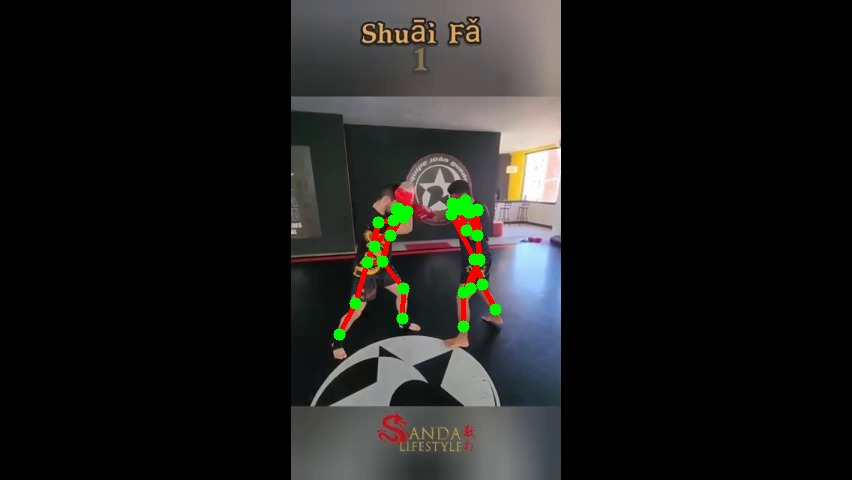

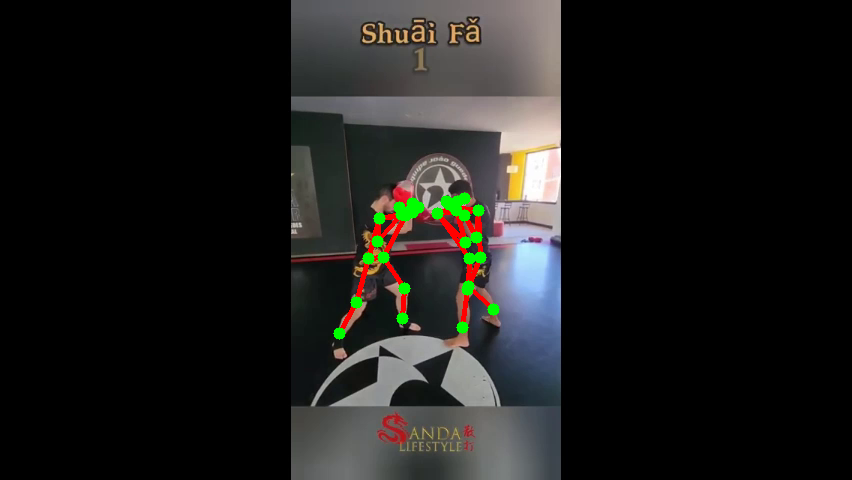

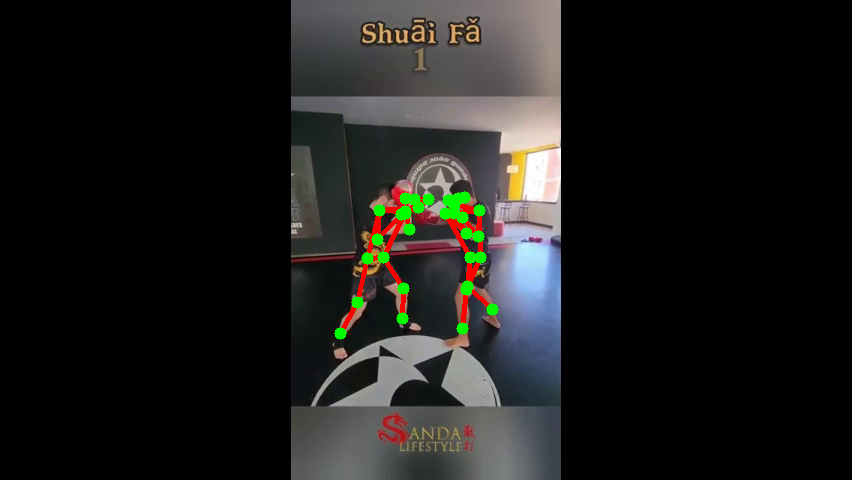

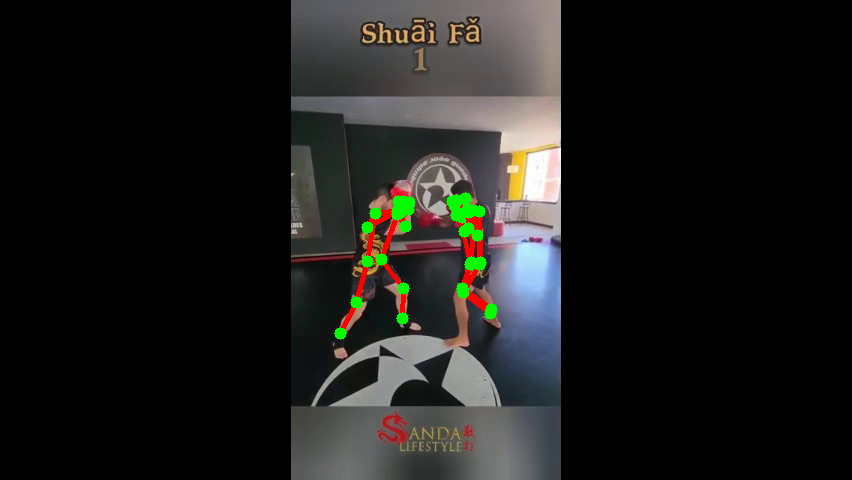

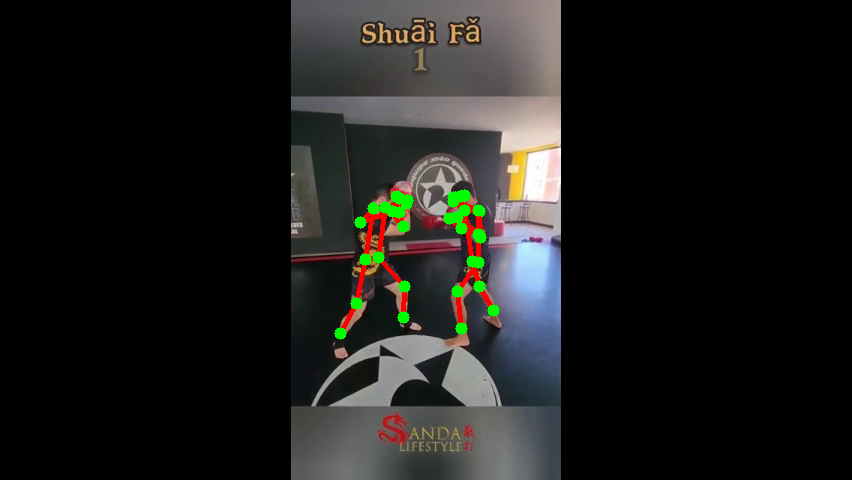

...

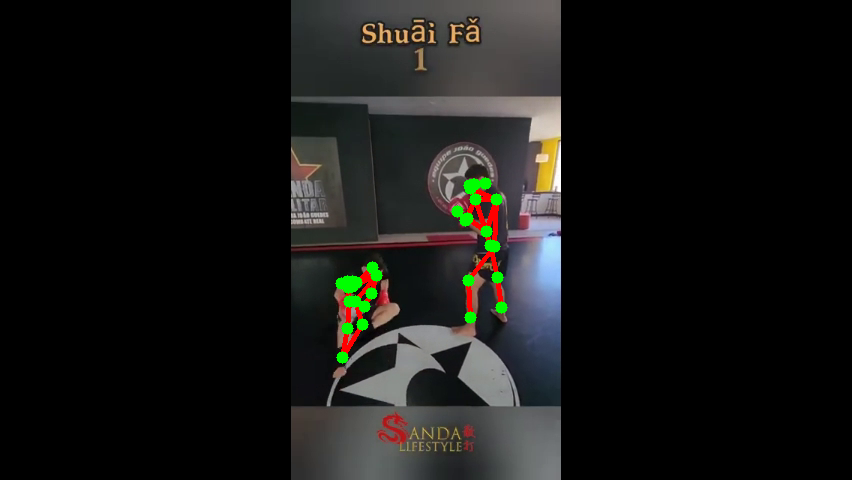

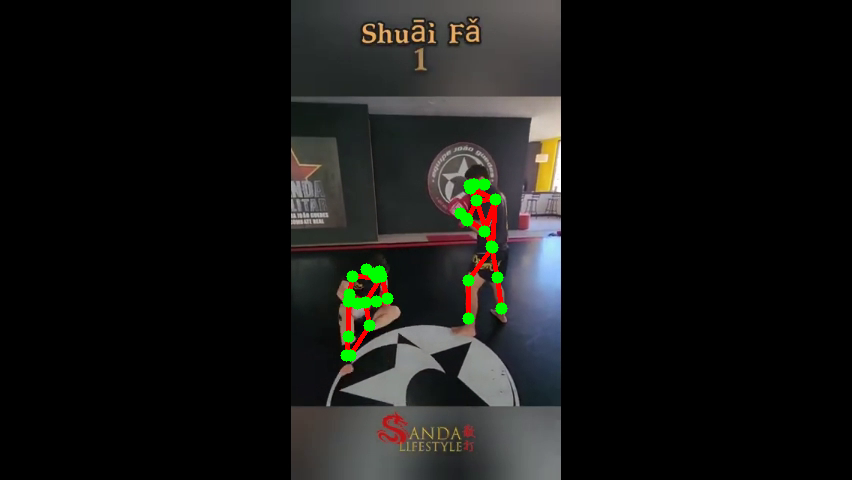

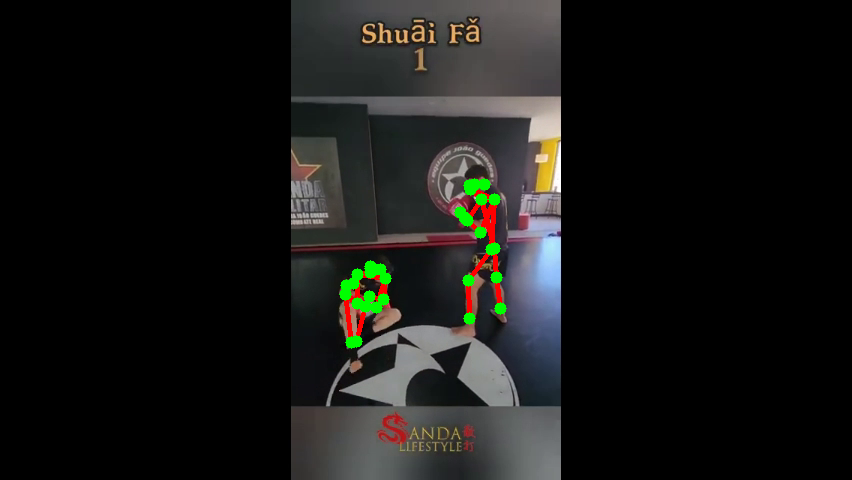

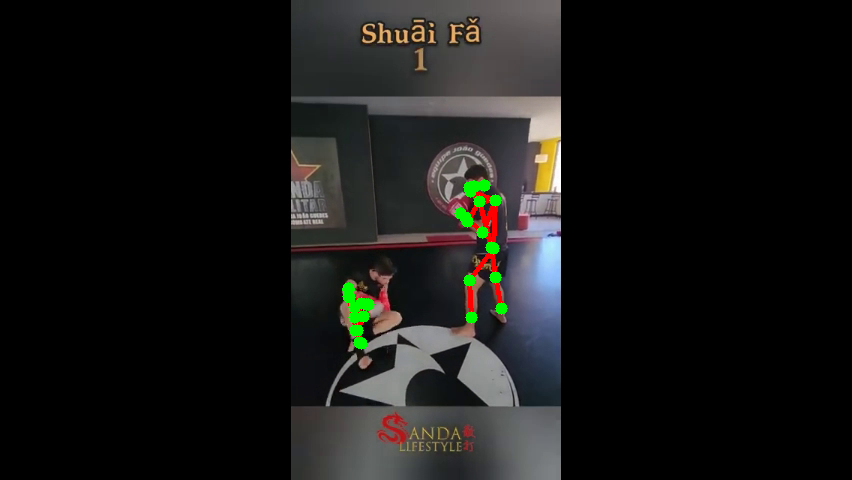

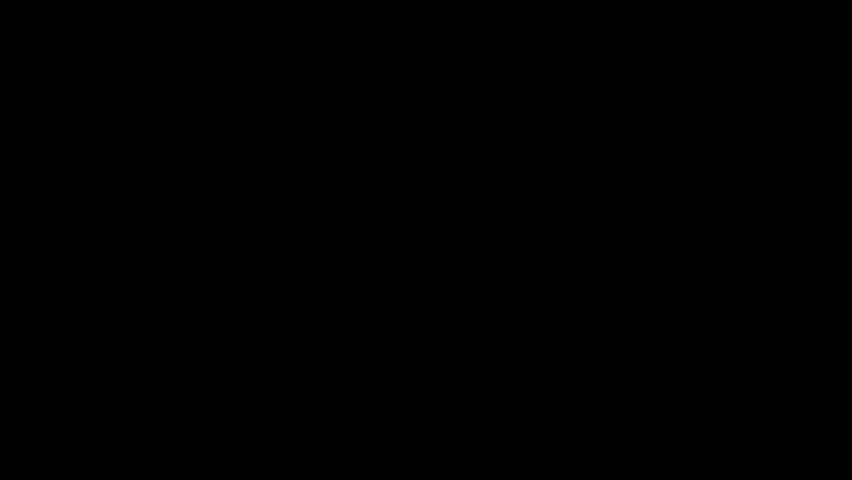

AttributeError: 'NoneType' object has no attribute 'copy'

In [10]:
cap = cv2.VideoCapture('/content/Untitled video - Made with Clipchamp (6).mp4')
while cap.isOpened():
    ret, frame = cap.read()

    # Resize image
    img = frame.copy()
    img = tf.image.resize_with_pad(tf.expand_dims(img, axis=0), 384,640)
    input_img = tf.cast(img, dtype=tf.int32)

    # Detection section
    results = movenet(input_img)
    keypoints_with_scores = results['output_0'].numpy()[:,:,:51].reshape((6,17,3))

    # Render keypoints
    loop_through_people(frame, keypoints_with_scores, EDGES, 0.1)
    #cv2.imshow('Movenet Multipose', frame)
    cv2_imshow(frame)
    if cv2.waitKey(10) & 0xFF==ord('q'):
        break
cap.release()
cv2.destroyAllWindows()

In [11]:
img = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)

error: OpenCV(4.8.0) /io/opencv/modules/imgproc/src/color.cpp:182: error: (-215:Assertion failed) !_src.empty() in function 'cvtColor'


In [12]:
keypoints_with_scores

array([[[4.85104918e-02, 8.40507984e-01, 5.30522056e-02],
        [5.22719137e-02, 8.49171162e-01, 4.19455841e-02],
        [4.98385690e-02, 8.43448818e-01, 3.70369740e-02],
        [5.00924401e-02, 8.62834156e-01, 2.40905881e-02],
        [4.60732579e-02, 8.50706398e-01, 2.14016121e-02],
        [4.47874628e-02, 8.62372339e-01, 4.34965342e-02],
        [4.10033241e-02, 8.28127384e-01, 3.13853696e-02],
        [5.28737865e-02, 8.36495399e-01, 8.27164296e-03],
        [4.58646081e-02, 8.08709621e-01, 2.92684697e-03],
        [1.29830083e-02, 8.10997486e-01, 4.11361828e-03],
        [2.89776176e-02, 8.03685963e-01, 2.41143699e-03],
        [4.89248745e-02, 8.25875282e-01, 4.01750393e-02],
        [4.36458066e-02, 8.17094147e-01, 1.18864672e-02],
        [5.04257530e-02, 7.97832429e-01, 1.17708081e-02],
        [4.55763265e-02, 7.94275522e-01, 7.20772706e-03],
        [7.83888847e-02, 7.99615741e-01, 8.61285999e-03],
        [6.62916079e-02, 8.07481587e-01, 6.69196527e-03]],

       [[2.7

In [13]:
32*12

384

In [5]:
# Function to loop through each person detected and render
def loop_through_people(frame, keypoints_with_scores, edges, confidence_threshold):
    for person in keypoints_with_scores:
        draw_connections(frame, person, edges, confidence_threshold)
        draw_keypoints(frame, person, confidence_threshold)

# 3. Draw Keypoints

In [6]:
def draw_keypoints(frame, keypoints, confidence_threshold):
    y, x, c = frame.shape
    shaped = np.squeeze(np.multiply(keypoints, [y,x,1]))

    for kp in shaped:
        ky, kx, kp_conf = kp
        if kp_conf > confidence_threshold:
            cv2.circle(frame, (int(kx), int(ky)), 6, (0,255,0), -1)

# 4. Draw Edges

In [7]:
EDGES = {
    (0, 1): 'm',
    (0, 2): 'c',
    (1, 3): 'm',
    (2, 4): 'c',
    (0, 5): 'm',
    (0, 6): 'c',
    (5, 7): 'm',
    (7, 9): 'm',
    (6, 8): 'c',
    (8, 10): 'c',
    (5, 6): 'y',
    (5, 11): 'm',
    (6, 12): 'c',
    (11, 12): 'y',
    (11, 13): 'm',
    (13, 15): 'm',
    (12, 14): 'c',
    (14, 16): 'c'
}

In [8]:
def draw_connections(frame, keypoints, edges, confidence_threshold):
    y, x, c = frame.shape
    shaped = np.squeeze(np.multiply(keypoints, [y,x,1]))

    for edge, color in edges.items():
        p1, p2 = edge
        y1, x1, c1 = shaped[p1]
        y2, x2, c2 = shaped[p2]

        if (c1 > confidence_threshold) & (c2 > confidence_threshold):
            cv2.line(frame, (int(x1), int(y1)), (int(x2), int(y2)), (0,0,255), 4)

In [14]:
import cv2

# Open the video file
video_path = '/content/Untitled video - Made with Clipchamp (6).mp4'
video = cv2.VideoCapture(video_path)

# Initialize the bounding boxes for the two players
player1_bbox = None
player2_bbox = None

# Initialize the scores for the two players
player1_score = 0
player2_score = 0

while True:
    ret, frame = video.read()
    if not ret:
        break

    # Perform object detection or tracking to get the bounding boxes for the two players
    # You can use techniques like background subtraction, object tracking, or pre-trained models
    # For this example, let's assume we have obtained the bounding boxes
    player1_bbox, player2_bbox = detect_players(frame)

    # Preprocess the frame
    blob = cv2.dnn.blobFromImage(frame, 1.0 / 255, (width, height), (0, 0, 0), swapRB=False, crop=False)

    # Perform inference on the frame using the OpenPose model
    net.setInput(blob)
    out = net.forward()
    H = out.shape[2]
    W = out.shape[3]

    # Extract the skeleton points from the output
    player1_points, player2_points = extract_keypoints(out, H, W)

    # Recognize the action for each player
    player1_action = recognize_action(player1_points)
    player2_action = recognize_action(player2_points)

    # Assign scores based on the recognized actions
    if player1_action == 'Punch' or player1_action == 'Kick':
        player1_score += 1
    elif player2_action == 'Punch' or player2_action == 'Kick':
        player2_score += 1

    # Draw the bounding boxes and scores on the frame
    cv2.rectangle(frame, (player1_bbox[0], player1_bbox[1]), (player1_bbox[2], player1_bbox[3]), (0, 255, 0), 2)
    cv2.putText(frame, f"Player 1 Score: {player1_score}", (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)

    cv2.rectangle(frame, (player2_bbox[0], player2_bbox[1]), (player2_bbox[2], player2_bbox[3]), (0, 0, 255), 2)
    cv2.putText(frame, f"Player 2 Score: {player2_score}", (10, 60), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 0, 255), 2)

    # Display the frame (optional)
    cv2.imshow('Boxing', frame)
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# Release resources
video.release()
cv2.destroyAllWindows()

NameError: name 'detect_players' is not defined

In [15]:
def recognize_action(keypoints):
    # Define rules to recognize punches and kicks based on the keypoints
    # This is just a simple example, you may need to define more complex rules
    if keypoints[9, 2] > keypoints[7, 2]:  # Right hand higher than right shoulder
        return 'Punch'
    elif keypoints[10, 2] > keypoints[8, 2]:  # Left hand higher than left shoulder
        return 'Punch'
    elif keypoints[15, 2] > keypoints[13, 2]:  # Right leg higher than right hip
        return 'Kick'
    elif keypoints[16, 2] > keypoints[14, 2]:  # Left leg higher than left hip
        return 'Kick'
    else:
        return 'None'

In [16]:
def recognize_action(keypoints):
    # Fix the indices to access valid keypoints
    if keypoints_with_scores[5, 2] > keypoints_with_scores[3, 2]:  # Right hand higher than right shoulder
        return 'Punch'
    elif keypoints_with_scores[4, 2] > keypoints_with_scores[2, 2]:  # Left hand higher than left shoulder
        return 'Punch'
    elif keypoints_with_scores[11, 2] > keypoints_with_scores[9, 2]:  # Right leg higher than right hip
        return 'Kick'
    elif keypoints_with_scores[10, 2] > keypoints_with_scores[8, 2]:  # Left leg higher than left hip
        return 'Kick'
    else:
        return 'None'

In [17]:
def recognize_action(keypoints_with_scores):
    # Check the shape of the input array
    if len(keypoints_with_scores.shape) != 3 or keypoints_with_scores.shape[2] != 3:
        print("Invalid keypoints array structure")
        return 'None'

    num_keypoints = keypoints_with_scores.shape[0]

    # Find the indices of the relevant keypoints
    right_hand_idx = None
    right_shoulder_idx = None
    left_hand_idx = None
    left_shoulder_idx = None
    right_leg_idx = None
    right_hip_idx = None
    left_leg_idx = None
    left_hip_idx = None

    for i in range(num_keypoints):
        if EDGES.get((7, i), None) == 'm':
            right_hand_idx = i
        elif EDGES.get((5, i), None) == 'm':
            right_shoulder_idx = i
        elif EDGES.get((8, i), None) == 'c':
            left_hand_idx = i
        elif EDGES.get((6, i), None) == 'c':
            left_shoulder_idx = i
        elif EDGES.get((13, i), None) == 'm':
            right_leg_idx = i
        elif EDGES.get((11, i), None) == 'm':
            right_hip_idx = i
        elif EDGES.get((14, i), None) == 'c':
            left_leg_idx = i
        elif EDGES.get((12, i), None) == 'c':
            left_hip_idx = i

    # Check if the relevant keypoints are found
    if (
        right_hand_idx is None
        or right_shoulder_idx is None
        or left_hand_idx is None
        or left_shoulder_idx is None
        or right_leg_idx is None
        or right_hip_idx is None
        or left_leg_idx is None
        or left_hip_idx is None
    ):
        print("Unable to find all relevant keypoints")
        return 'None'

    # Extract the confidence values for the relevant keypoints
    right_hand_conf = keypoints_with_scores[right_hand_idx, 2]
    right_shoulder_conf = keypoints_with_scores[right_shoulder_idx, 2]
    left_hand_conf = keypoints_with_scores[left_hand_idx, 2]
    left_shoulder_conf = keypoints_with_scores[left_shoulder_idx, 2]
    right_leg_conf = keypoints_with_scores[right_leg_idx, 2]
    right_hip_conf = keypoints_with_scores[right_hip_idx, 2]
    left_leg_conf = keypoints_with_scores[left_leg_idx, 2]
    left_hip_conf = keypoints_with_scores[left_hip_idx, 2]

    # Recognize the action based on the keypoints
    if right_hand_conf > right_shoulder_conf:
        return 'Punch'
    elif left_hand_conf > left_shoulder_conf:
        return 'Punch'
    elif right_leg_conf > right_hip_conf:
        return 'Kick'
    elif left_leg_conf > left_hip_conf:
        return 'Kick'
    else:
        return 'None'

In [18]:
def assign_score(action):
    if action == 'Punch':
        return 2  # Assign a score of 2 for a punch
    elif action == 'Kick':
        return 3  # Assign a score of 3 for a kick
    else:
        return 0  # Assign a score of 0 for no action

In [19]:
# Open the video file
#cap = cv2.VideoCapture('/content/Wushu Sanda - Shuāi Fǎ_ KungFu Sanshou Takedows #luta #viral #sanda #shorts #short #video #wushu.mp4')

# Initialize variables to keep track of scores
player1_score = 0
player2_score = 0



    # Recognize the action based on the keypoints
action = recognize_action(keypoints_with_scores)

    # Assign scores based on the recognized action
score = assign_score(action)

    # Update the scores for the players
    # You'll need to implement logic to identify the players
    # For example, you could use bounding boxes or player identification
if player_identified == 1:
  player1_score += score
else:
  player2_score += score

    # Display the frame and scores
cv2.imshow('Frame', frame)
print(f'Player 1 Score: {player1_score}, Player 2 Score: {player2_score}')

    # Press 'q' to quit the loop
if cv2.waitKey(1) & 0xFF == ord('q'):
  break

# Release the video capture object and close windows
cap.release()
cv2.destroyAllWindows()

Unable to find all relevant keypoints


NameError: name 'player_identified' is not defined

In [22]:

# Load the MoveNet model
model = hub.load('https://tfhub.dev/google/movenet/multipose/lightning/1')
movenet = model.signatures['serving_default']

# Define the edges for drawing the skeleton
EDGES = {
    (0, 1): 'm',
    (0, 2): 'c',
    (1, 3): 'm',
    (2, 4): 'c',
    (0, 5): 'm',
    (0, 6): 'c',
    (5, 7): 'm',
    (7, 9): 'm',
    (6, 8): 'c',
    (8, 10): 'c',
    (5, 6): 'y',
    (5, 11): 'm',
    (6, 12): 'c',
    (11, 12): 'y',
    (11, 13): 'm',
    (13, 15): 'm',
    (12, 14): 'c',
    (14, 16): 'c'
}

# Function to draw the keypoints on the frame
def draw_keypoints(frame, keypoints, confidence_threshold):
    y, x, c = frame.shape
    shaped = np.squeeze(np.multiply(keypoints, [y, x, 1]))

    for kp in shaped:
        ky, kx, kp_conf = kp
        if kp_conf > confidence_threshold:
            cv2.circle(frame, (int(kx), int(ky)), 6, (0, 255, 0), -1)

# Function to draw the connections between keypoints
def draw_connections(frame, keypoints, edges, confidence_threshold):
    y, x, c = frame.shape
    shaped = np.squeeze(np.multiply(keypoints, [y, x, 1]))

    for edge, color in edges.items():
        p1, p2 = edge
        y1, x1, c1 = shaped[p1]
        y2, x2, c2 = shaped[p2]

        if (c1 > confidence_threshold) & (c2 > confidence_threshold):
            cv2.line(frame, (int(x1), int(y1)), (int(x2), int(y2)), (0, 0, 255), 4)

# Function to loop through each person detected and render
def loop_through_people(frame, keypoints_with_scores, edges, confidence_threshold):
    player1_points = None
    player2_points = None
    player1_center = None
    player2_center = None

    for i, person in enumerate(keypoints_with_scores):
        # Calculate the center point of the person based on the keypoints
        person_center = np.mean(person[:, :2], axis=0)

        if player1_center is None:
            player1_points = person
            player1_center = person_center
        else:
            player2_points = person
            player2_center = person_center

    # Render the keypoints and connections for each player
    if player1_points is not None:
        draw_keypoints(frame, player1_points, confidence_threshold)
        draw_connections(frame, player1_points, edges, confidence_threshold)

    if player2_points is not None:
        draw_keypoints(frame, player2_points, confidence_threshold)
        draw_connections(frame, player2_points, edges, confidence_threshold)

    # You can extract bounding boxes from the keypoint locations if needed
    player1_bbox = extract_bounding_box_from_keypoints(player1_points) if player1_points is not None else None
    player2_bbox = extract_bounding_box_from_keypoints(player2_points) if player2_points is not None else None

    return player1_bbox, player2_bbox

'''def loop_through_people(frame, keypoints_with_scores, edges, confidence_threshold):
    player1_bbox = None
    player2_bbox = None
    player1_points = None
    player2_points = None

    for i, person in enumerate(keypoints_with_scores):
        bbox = extract_bounding_box(person)  # Implement this function to extract the bounding box

        if player1_bbox is None:
            player1_bbox = bbox
            player1_points = person
        else:
            player2_bbox = bbox
            player2_points = person

    # Render the keypoints and connections for each player
    draw_keypoints(frame, player1_points, confidence_threshold)
    draw_connections(frame, player1_points, edges, confidence_threshold)

    if player2_points is not None:
        draw_keypoints(frame, player2_points, confidence_threshold)
        draw_connections(frame, player2_points, edges, confidence_threshold)

    return player1_bbox, player2_bbox
'''
# Open the video file
cap = cv2.VideoCapture('/content/Untitled video - Made with Clipchamp (6).mp4')

# Initialize the scores for the two players
player1_score = 0
player2_score = 0

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    # Resize the image
    img = frame.copy()
    img = tf.image.resize_with_pad(tf.expand_dims(img, axis=0), 384, 640)
    input_img = tf.cast(img, dtype=tf.int32)

    # Perform pose estimation
    results = movenet(input_img)
    keypoints_with_scores = results['output_0'].numpy()[:, :, :51].reshape((6, 17, 3))

    # Identify the players and render the keypoints and connections
    player1_bbox, player2_bbox = loop_through_people(frame, keypoints_with_scores, EDGES, 0.1)

    # Recognize the actions and update the scores
    # You can implement the action recognition logic here
    # ...
    def recognize_action(keypoints_with_scores):

    # Check the shape of the input array
      if len(keypoints_with_scores.shape) != 3 or keypoints_with_scores.shape[2] != 3:
          print("Invalid keypoints array structure")
          return 'None'

      num_keypoints = keypoints_with_scores.shape[0]

      # Find the indices of the relevant keypoints
      right_hand_idx = None
      right_shoulder_idx = None
      left_hand_idx = None
      left_shoulder_idx = None
      right_leg_idx = None
      right_hip_idx = None
      left_leg_idx = None
      left_hip_idx = None

      for i in range(num_keypoints):
          if EDGES.get((7, i), None) == 'm':
              right_hand_idx = i
          elif EDGES.get((5, i), None) == 'm':
              right_shoulder_idx = i
          elif EDGES.get((8, i), None) == 'c':
              left_hand_idx = i
          elif EDGES.get((6, i), None) == 'c':
              left_shoulder_idx = i
          elif EDGES.get((13, i), None) == 'm':
              right_leg_idx = i
          elif EDGES.get((11, i), None) == 'm':
              right_hip_idx = i
          elif EDGES.get((14, i), None) == 'c':
              left_leg_idx = i
          elif EDGES.get((12, i), None) == 'c':
              left_hip_idx = i

      # Check if the relevant keypoints are found
      if (
          right_hand_idx is None
          or right_shoulder_idx is None
          or left_hand_idx is None
          or left_shoulder_idx is None
          or right_leg_idx is None
          or right_hip_idx is None
          or left_leg_idx is None
          or left_hip_idx is None
      ):
          print("Unable to find all relevant keypoints")
          return 'None'

      # Extract the confidence values for the relevant keypoints
      right_hand_conf = keypoints_with_scores[right_hand_idx, 2]
      right_shoulder_conf = keypoints_with_scores[right_shoulder_idx, 2]
      left_hand_conf = keypoints_with_scores[left_hand_idx, 2]
      left_shoulder_conf = keypoints_with_scores[left_shoulder_idx, 2]
      right_leg_conf = keypoints_with_scores[right_leg_idx, 2]
      right_hip_conf = keypoints_with_scores[right_hip_idx, 2]
      left_leg_conf = keypoints_with_scores[left_leg_idx, 2]
      left_hip_conf = keypoints_with_scores[left_hip_idx, 2]

      # Recognize the action based on the keypoints
      if right_hand_conf > right_shoulder_conf:
          return 'Punch'
      elif left_hand_conf > left_shoulder_conf:
          return 'Punch'
      elif right_leg_conf > right_hip_conf:
          return 'Kick'
      elif left_leg_conf > left_hip_conf:
          return 'Kick'
      else:
          return 'None'

    # Draw the bounding boxes and scores on the frame
    if player1_bbox is not None:
        x1, y1, x2, y2 = player1_bbox
        cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)
        cv2.putText(frame, f"Player 1 Score: {player1_score}", (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)

    if player2_bbox is not None:
        x1, y1, x2, y2 = player2_bbox
        cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 0, 255), 2)
        cv2.putText(frame, f"Player 2 Score: {player2_score}", (10, 60), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 0, 255), 2)

    # Display the frame
    cv2.imshow('Boxing', frame)

    if cv2.waitKey(10) & 0xFF == ord('q'):
        break

cap.release()
cv2.destroyAllWindows()

ValueError: not enough values to unpack (expected 4, got 2)

In [43]:
def extract_bounding_box_from_keypoints(keypoints):
  """
  Extracts the bounding box coordinates from the keypoints of a person.

  Args:
    keypoints: A 2D array of shape (17, 3) containing the keypoints of a person.

  Returns:
    A tuple containing the coordinates of the top-left and bottom-right corners of the bounding box.
  """

  # Find the minimum and maximum x and y coordinates of the keypoints
  x_min = np.min(keypoints[:, 0])
  y_min = np.min(keypoints[:, 1])
  x_max = np.max(keypoints[:, 0])
  y_max = np.max(keypoints[:, 1])

  # Return the bounding box coordinates
  return (x_min, y_min), (x_max, y_max)

In [27]:
!pip install numpy scipy opencv-python

In [ ]:
!git clone https://github.com/nwojke/deep_sort.git

fatal: destination path 'deep_sort' already exists and is not an empty directory.


In [28]:
!pip install deepsort

  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 30.5/30.5 MB 26.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 33.7/33.7 MB 12.8 MB/s eta 0:00:00
  Created wheel for deepsort: filename=deepsort-0.0.5-py3-none-any.whl size=13988 sha256=5e0c7c51cc719850bcc7f4844c265bafa30d578bac2c2adf948294fb7de043b5
  Stored in directory: /root/.cache/pip/wheels/54/df/f3/65264ae4fa99ecade818c448c92ede0af2b4b7bd4ad6efd8ab
Successfully built deepsort
  Attempting uninstall: scipy
    Found existing installation: scipy 1.11.4
    Uninstalling scipy-1.11.4:
      Successfully uninstalled scipy-1.11.4
  Attempting uninstall: scikit-learn
    Found existing installation: scikit-learn 1.2.2
    Uninstalling scikit-learn-1.2.2:
      Successfully uninstalled scikit-learn-1.2.2
ERROR: pip's dependency resolver does not currently take into account all the packages 

In [ ]:
pip install --upgrade deepsort

In [37]:
import deepsort as deep_sort

In [30]:
!apt-get install deep_sort

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
E: Unable to locate package deep_sort


In [38]:
from deep_sort import DeepSort

ModuleNotFoundError: No module named 'deep_sort'

In [32]:
!pip install DeepSort

In [ ]:
pip install --upgrade DeepSort

In [33]:
deepsort = DeepSort()

NameError: name 'DeepSort' is not defined

In [39]:
from deepsort import DeepSortTracker

In [40]:
from deepsort.tracker import DeepSortTracker

In [41]:
object_tracker = DeepSort()

NameError: name 'DeepSort' is not defined

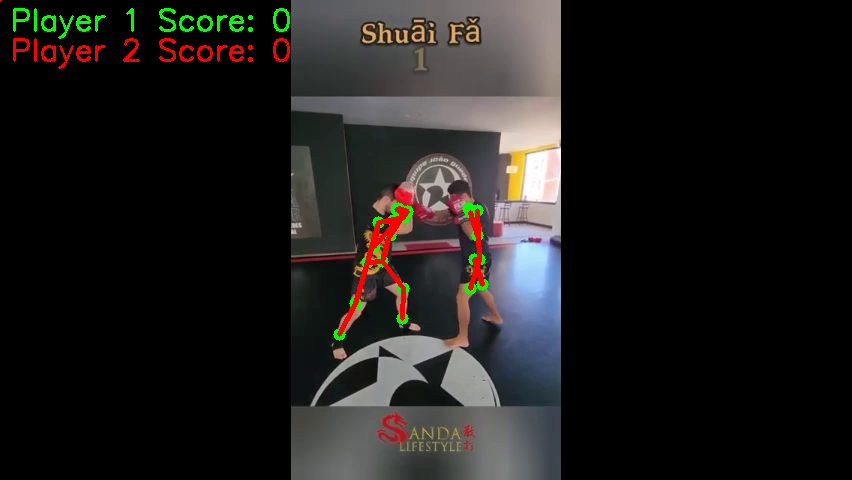

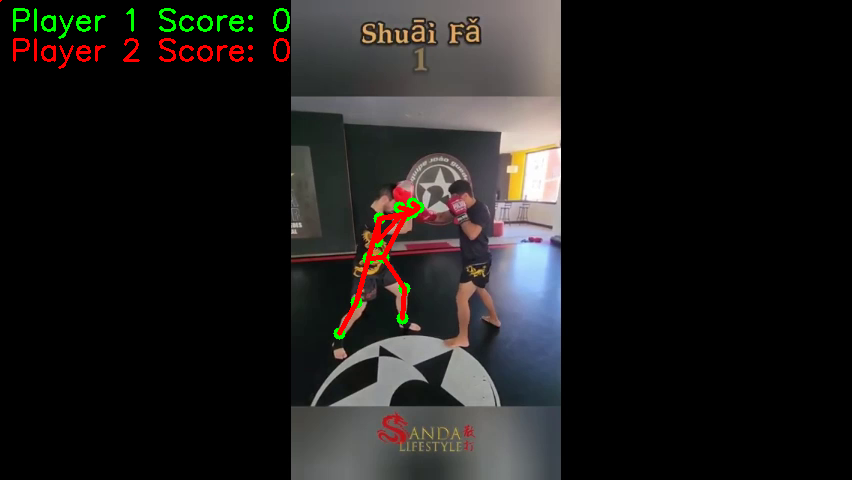

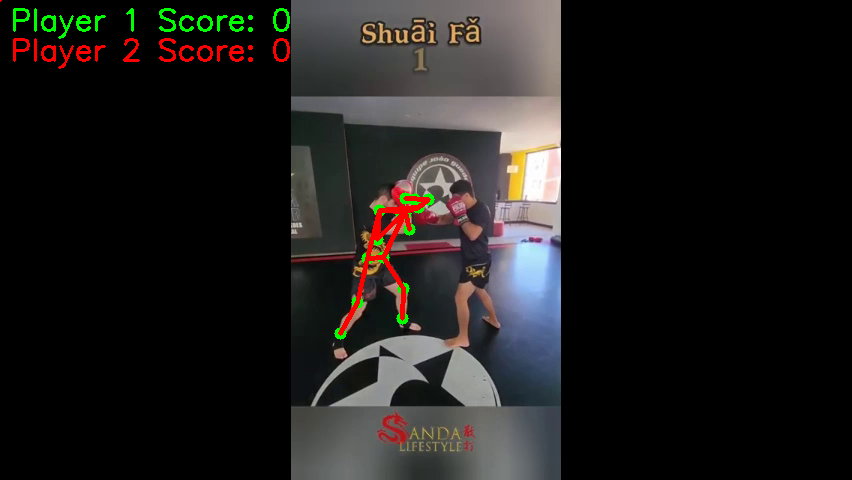

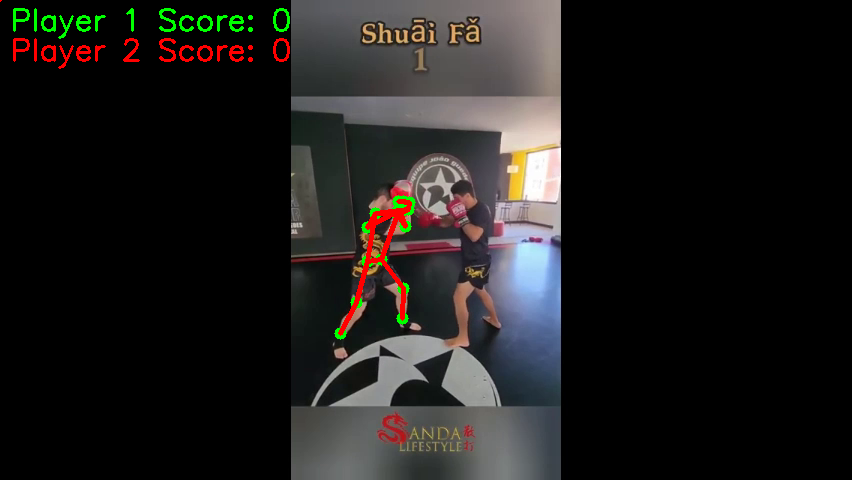

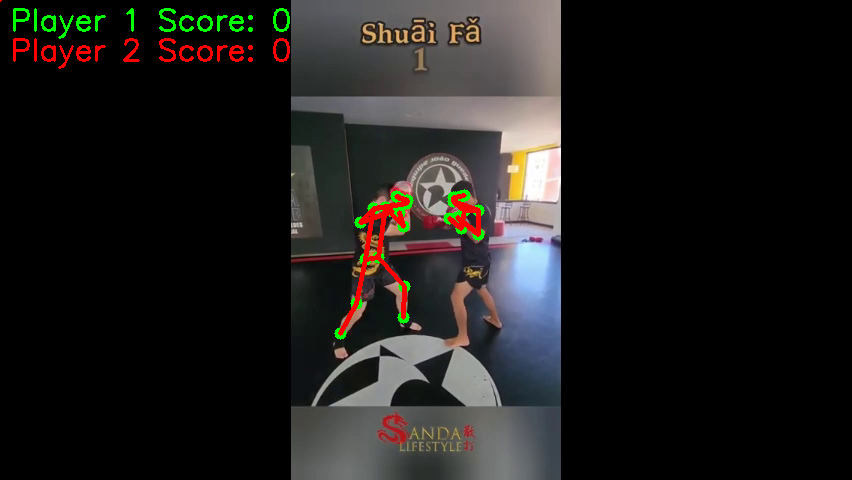

...

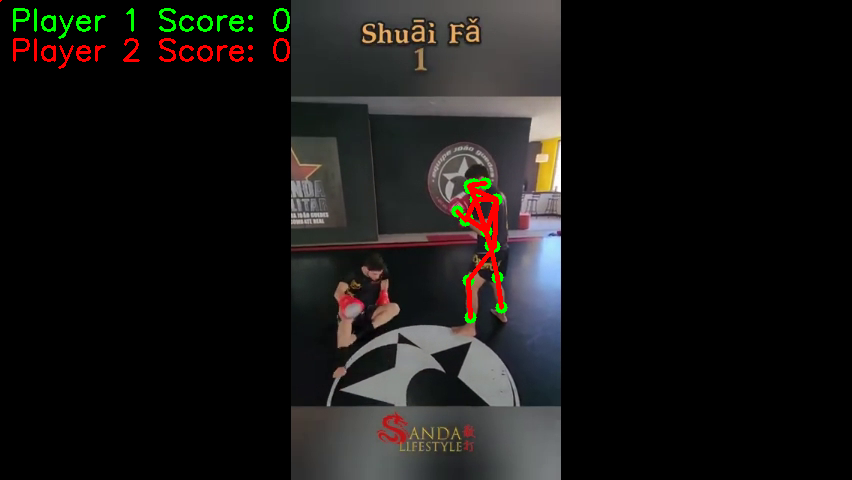

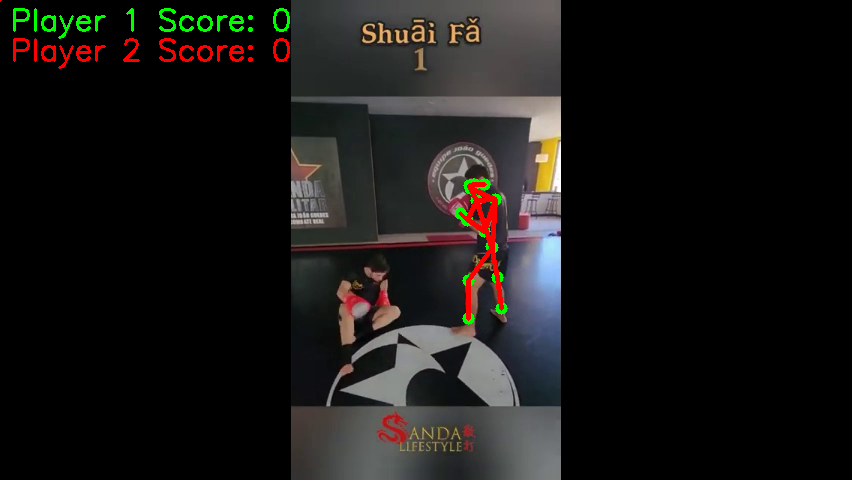

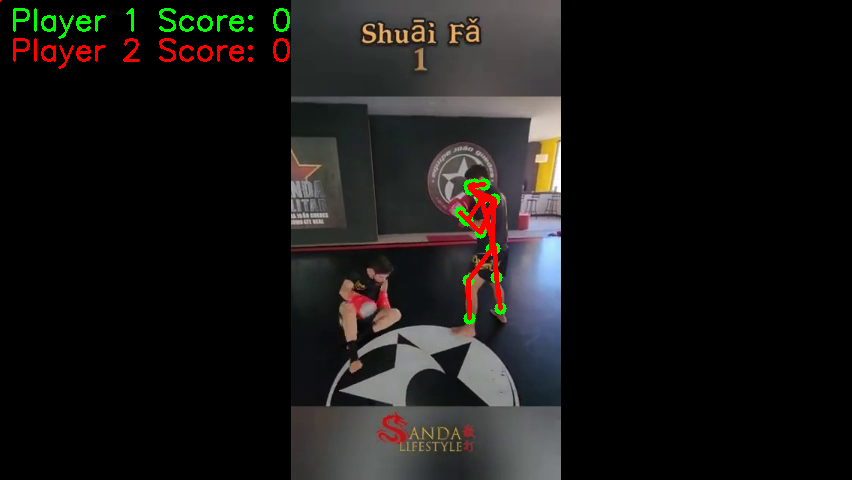

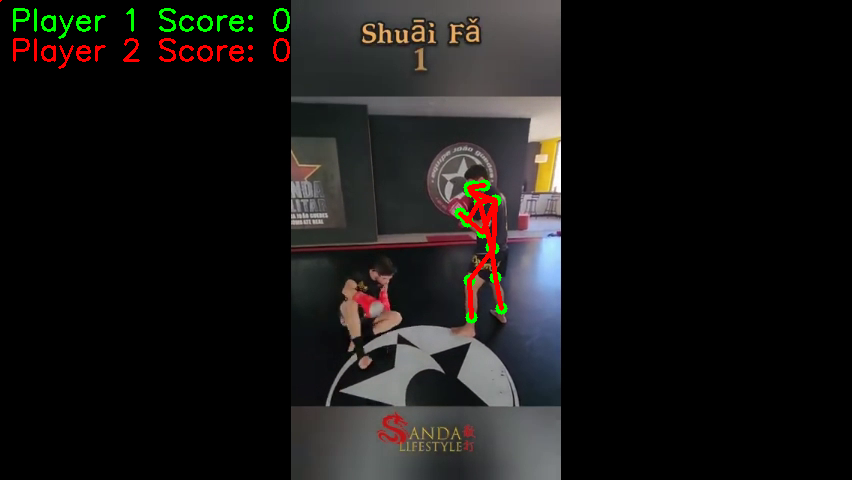

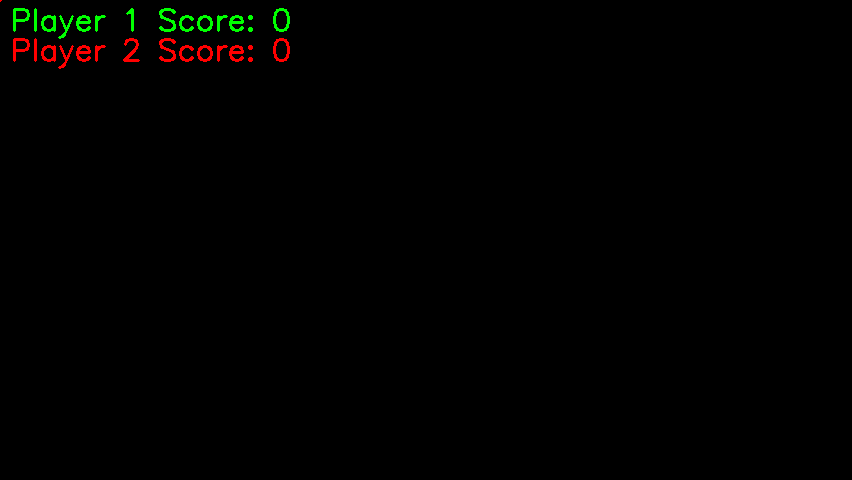

In [44]:

# Load the MoveNet model
model = hub.load('https://tfhub.dev/google/movenet/multipose/lightning/1')
movenet = model.signatures['serving_default']

# Define the edges for drawing the skeleton
EDGES = {
    (0, 1): 'm',
    (0, 2): 'c',
    (1, 3): 'm',
    (2, 4): 'c',
    (0, 5): 'm',
    (0, 6): 'c',
    (5, 7): 'm',
    (7, 9): 'm',
    (6, 8): 'c',
    (8, 10): 'c',
    (5, 6): 'y',
    (5, 11): 'm',
    (6, 12): 'c',
    (11, 12): 'y',
    (11, 13): 'm',
    (13, 15): 'm',
    (12, 14): 'c',
    (14, 16): 'c'
}

# Function to draw the keypoints on the frame
def draw_keypoints(frame, keypoints, confidence_threshold):
    y, x, c = frame.shape
    shaped = np.squeeze(np.multiply(keypoints, [y, x, 1]))

    for kp in shaped:
        ky, kx, kp_conf = kp
        if kp_conf > confidence_threshold:
            cv2.circle(frame, (int(kx), int(ky)), 6, (0, 255, 0), -1)

# Function to draw the connections between keypoints
def draw_connections(frame, keypoints, edges, confidence_threshold):
    y, x, c = frame.shape
    shaped = np.squeeze(np.multiply(keypoints, [y, x, 1]))

    for edge, color in edges.items():
        p1, p2 = edge
        y1, x1, c1 = shaped[p1]
        y2, x2, c2 = shaped[p2]

        if (c1 > confidence_threshold) & (c2 > confidence_threshold):
            cv2.line(frame, (int(x1), int(y1)), (int(x2), int(y2)), (0, 0, 255), 4)

# Function to loop through each person detected and render
def extract_bounding_box_from_keypoints(keypoints):
    x_coords = keypoints[:, 0]
    y_coords = keypoints[:, 1]
    x_min, x_max = int(np.min(x_coords)), int(np.max(x_coords))
    y_min, y_max = int(np.min(y_coords)), int(np.max(y_coords))
    return x_min, y_min, x_max, y_max

# Function to loop through each person detected and render
'''def loop_through_people(frame, keypoints_with_scores, edges, confidence_threshold):
    player_boxes = []
    player_points = []

    for person in keypoints_with_scores:
        bbox = extract_bounding_box_from_keypoints(person)
        player_boxes.append(bbox)
        player_points.append(person)

    #tracker = deepsort.DeepSort(max_age=50)

    # Use Deep SORT to track the players
    detections = np.array(player_boxes)
    #tracked_objects = deepsort.update(detections)
    #tracked_objects = DeepSortTracker.update(detections, frame)
    detections = np.array([[x1, y1, x2, y2], ...])

    tracker = DeepSortTracker()

# Use the tracker to update with detections
    tracked_objects = tracker.update(detections)



    # Render the keypoints and connections for tracked players
    for track_id, bbox in enumerate(tracked_objects[:, :4]):
        x1, y1, x2, y2 = [int(coord) for coord in bbox]

        # Find the corresponding keypoints for the tracked player
        player_idx = track_id if track_id < len(player_points) else None
        player_keypoints = player_points[player_idx] if player_idx is not None else None

        if player_keypoints is not None:
            draw_keypoints(frame, player_keypoints, confidence_threshold)
            draw_connections(frame, player_keypoints, edges, confidence_threshold)

        cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)
        cv2.putText(frame, f"Player {track_id + 1}", (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

    return None, None  # Return None for player1_bbox and player2_bbox'''

def loop_through_people(frame, keypoints_with_scores, edges, confidence_threshold):
    player1_points = None
    player2_points = None
    player1_center = None
    player2_center = None

    for i, person in enumerate(keypoints_with_scores):
        # Calculate the center point of the person based on the keypoints
        person_center = np.mean(person[:, :2], axis=0)

        if player1_center is None:
            player1_points = person
            player1_center = person_center
        else:
            player2_points = person
            player2_center = person_center

    # Render the keypoints and connections for each player
    if player1_points is not None:
        draw_keypoints(frame, player1_points, confidence_threshold)
        draw_connections(frame, player1_points, edges, confidence_threshold)

    if player2_points is not None:
        draw_keypoints(frame, player2_points, confidence_threshold)
        draw_connections(frame, player2_points, edges, confidence_threshold)

    # Extract bounding boxes from the keypoint locations
    player1_bbox = extract_bounding_box_from_keypoints(player1_points) if player1_points is not None else None
    player2_bbox = extract_bounding_box_from_keypoints(player2_points) if player2_points is not None else None

    return player1_bbox, player2_bbox

'''def loop_through_people(frame, keypoints_with_scores, edges, confidence_threshold):
    player1_bbox = None
    player2_bbox = None
    player1_points = None
    player2_points = None

    for i, person in enumerate(keypoints_with_scores):
        bbox = extract_bounding_box(person)  # Implement this function to extract the bounding box

        if player1_bbox is None:
            player1_bbox = bbox
            player1_points = person
        else:
            player2_bbox = bbox
            player2_points = person

    # Render the keypoints and connections for each player
    draw_keypoints(frame, player1_points, confidence_threshold)
    draw_connections(frame, player1_points, edges, confidence_threshold)

    if player2_points is not None:
        draw_keypoints(frame, player2_points, confidence_threshold)
        draw_connections(frame, player2_points, edges, confidence_threshold)

    return player1_bbox, player2_bbox'''

# Open the video file
cap = cv2.VideoCapture('/content/Untitled video - Made with Clipchamp (6).mp4')

# Initialize the scores for the two players
player1_score = 0
player2_score = 0

while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    # Resize the image
    img = frame.copy()
    img = tf.image.resize_with_pad(tf.expand_dims(img, axis=0), 384, 640)
    input_img = tf.cast(img, dtype=tf.int32)

    # Perform pose estimation
    results = movenet(input_img)
    keypoints_with_scores = results['output_0'].numpy()[:, :, :51].reshape((6, 17, 3))

    # Identify the players and render the keypoints and connections
    player1_bbox, player2_bbox = loop_through_people(frame, keypoints_with_scores, EDGES, 0.1)

    # Recognize the actions and update the scores
    # You can implement the action recognition logic here
    # ...
    def recognize_action(keypoints_with_scores):

    # Check the shape of the input array
      if len(keypoints_with_scores.shape) != 3 or keypoints_with_scores.shape[2] != 3:
          print("Invalid keypoints array structure")
          return 'None'

      num_keypoints = keypoints_with_scores.shape[0]

      # Find the indices of the relevant keypoints
      right_hand_idx = None
      right_shoulder_idx = None
      left_hand_idx = None
      left_shoulder_idx = None
      right_leg_idx = None
      right_hip_idx = None
      left_leg_idx = None
      left_hip_idx = None

      for i in range(num_keypoints):
          if EDGES.get((7, i), None) == 'm':
              right_hand_idx = i
          elif EDGES.get((5, i), None) == 'm':
              right_shoulder_idx = i
          elif EDGES.get((8, i), None) == 'c':
              left_hand_idx = i
          elif EDGES.get((6, i), None) == 'c':
              left_shoulder_idx = i
          elif EDGES.get((13, i), None) == 'm':
              right_leg_idx = i
          elif EDGES.get((11, i), None) == 'm':
              right_hip_idx = i
          elif EDGES.get((14, i), None) == 'c':
              left_leg_idx = i
          elif EDGES.get((12, i), None) == 'c':
              left_hip_idx = i

      # Check if the relevant keypoints are found
      if (
          right_hand_idx is None
          or right_shoulder_idx is None
          or left_hand_idx is None
          or left_shoulder_idx is None
          or right_leg_idx is None
          or right_hip_idx is None
          or left_leg_idx is None
          or left_hip_idx is None
      ):
          print("Unable to find all relevant keypoints")
          return 'None'

      # Extract the confidence values for the relevant keypoints
      right_hand_conf = keypoints_with_scores[right_hand_idx, 2]
      right_shoulder_conf = keypoints_with_scores[right_shoulder_idx, 2]
      left_hand_conf = keypoints_with_scores[left_hand_idx, 2]
      left_shoulder_conf = keypoints_with_scores[left_shoulder_idx, 2]
      right_leg_conf = keypoints_with_scores[right_leg_idx, 2]
      right_hip_conf = keypoints_with_scores[right_hip_idx, 2]
      left_leg_conf = keypoints_with_scores[left_leg_idx, 2]
      left_hip_conf = keypoints_with_scores[left_hip_idx, 2]

      # Recognize the action based on the keypoints
      if right_hand_conf > right_shoulder_conf:
          return 'Punch'
      elif left_hand_conf > left_shoulder_conf:
          return 'Punch'
      elif right_leg_conf > right_hip_conf:
          return 'Kick'
      elif left_leg_conf > left_hip_conf:
          return 'Kick'
      else:
          return 'None'

    # Draw the bounding boxes and scores on the frame
    if player1_bbox is not None:
        x1, y1, x2, y2 = player1_bbox
        cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)
        cv2.putText(frame, f"Player 1 Score: {player1_score}", (10, 30), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)

    if player2_bbox is not None:
        x1, y1, x2, y2 = player2_bbox
        cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 0, 255), 2)
        cv2.putText(frame, f"Player 2 Score: {player2_score}", (10, 60), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 0, 255), 2)

    # Display the frame
    cv2_imshow(frame)

    if cv2.waitKey(10) & 0xFF == ord('q'):
        break

cap.release()
cv2.destroyAllWindows()

In [ ]:
!pip show deepsort

Name: deepsort
Version: 0.0.5
Summary: Packaged version of the DeepSort repository
Home-page: https://github.com/kadirnar/deepsort-pip
Author: kadirnar
Author-email: 
License: MIT
Location: /usr/local/lib/python3.10/dist-packages
Requires: scikit-learn, scipy
Required-by: 


In [25]:

from google.colab.patches import cv2_imshow

In [ ]:
!pip install deep-sort

ERROR: Could not find a version that satisfies the requirement deep-sort (from versions: none)
ERROR: No matching distribution found for deep-sort


In [ ]:
!git clone https://github.com/MuhammadMoinFaisal/YOLOv8-DeepSORT-Object-Tracking.git

Cloning into 'YOLOv8-DeepSORT-Object-Tracking'...
remote: Enumerating objects: 403, done.
remote: Counting objects: 100% (33/33), done.
remote: Compressing objects: 100% (14/14), done.
remote: Total 403 (delta 21), reused 19 (delta 19), pack-reused 370
Receiving objects: 100% (403/403), 77.99 MiB | 26.45 MiB/s, done.
Resolving deltas: 100% (206/206), done.


In [ ]:
cd YOLOv8-DeepSORT-Object-Tracking

/content/YOLOv8-DeepSORT-Object-Tracking


In [ ]:
!pip install -e '.[dev]'

Obtaining file:///content/yolov4-deepsort/yolov4-deepsort/YOLOv8-DeepSORT-Object-Tracking
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 154.5/154.5 kB 3.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.3/207.3 kB 10.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 231.7/231.7 kB 6.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.9/3.9 MB 15.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.8/8.8 MB 26.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 kB 6.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.5/79.5 kB 8.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 117.0/117.0 kB 11.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  U

In [ ]:
%cd /content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect

/content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect


In [ ]:
!gdown "https://drive.google.com/uc?id=11ZSZcG-bcbueXZC3rN08CM0qqX3eiHxf&confirm=t"


Downloading...
From: https://drive.google.com/uc?id=11ZSZcG-bcbueXZC3rN08CM0qqX3eiHxf&confirm=t
To: /content/YOLOv8-DeepSORT-Object-Tracking/ultralytics/yolo/v8/detect/deep_sort_pytorch.zip
100% 43.1M/43.1M [00:02<00:00, 15.6MB/s]


In [ ]:
!unzip 'deep_sort_pytorch.zip'


Archive:  deep_sort_pytorch.zip
  inflating: deep_sort_pytorch/.gitignore  
   creating: deep_sort_pytorch/configs/
  inflating: deep_sort_pytorch/configs/deep_sort.yaml  
   creating: deep_sort_pytorch/deep_sort/
  inflating: deep_sort_pytorch/deep_sort/__init__.py  
   creating: deep_sort_pytorch/deep_sort/__pycache__/
  inflating: deep_sort_pytorch/deep_sort/__pycache__/__init__.cpython-310.pyc  
  inflating: deep_sort_pytorch/deep_sort/__pycache__/__init__.cpython-37.pyc  
  inflating: deep_sort_pytorch/deep_sort/__pycache__/__init__.cpython-38.pyc  
  inflating: deep_sort_pytorch/deep_sort/__pycache__/deep_sort.cpython-310.pyc  
  inflating: deep_sort_pytorch/deep_sort/__pycache__/deep_sort.cpython-37.pyc  
  inflating: deep_sort_pytorch/deep_sort/__pycache__/deep_sort.cpython-38.pyc  
   creating: deep_sort_pytorch/deep_sort/deep/
 extracting: deep_sort_pytorch/deep_sort/deep/__init__.py  
   creating: deep_sort_pytorch/deep_sort/deep/__pycache__/
  inflating: deep_sort_pytorch/d

In [ ]:
!python predict.py source="Untitled video - Made with Clipchamp (6).mp4"

mismatched input ' (' expecting <EOF>
See https://hydra.cc/docs/1.2/advanced/override_grammar/basic for details

Set the environment variable HYDRA_FULL_ERROR=1 for a complete stack trace.


In [ ]:
!python predict.py model=yolov8l.pt source="/content/Untitled video - Made with Clipchamp (6).mp4" show=True

mismatched input ' (' expecting <EOF>
See https://hydra.cc/docs/1.2/advanced/override_grammar/basic for details

Set the environment variable HYDRA_FULL_ERROR=1 for a complete stack trace.


In [ ]:
!pip install -q super-gradients==3.1.3
!pip install filterpy==1.1.0

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 4.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.3/139.3 kB 5.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 684.5/684.5 kB 10.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.9/2.9 MB 16.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.8/2.8 MB 25.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 408.6/408.6 kB 24.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 31.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.5/13.5 MB 42.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 68.0/68.0 kB 6.2 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
  Preparing metada

In [ ]:
!pip install deep-sort-realtime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.4/8.4 MB 13.9 MB/s eta 0:00:00


In [ ]:
from deep_sort_realtime.deepsort_tracker import DeepSort

In [ ]:
deepsort = DeepSort()